Coloque o arquivo a ser importado no Google Drive e monte-o:

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


#Instalação do plugin YData Profiling (anteriormente, Pandas Profiling)
Este plugin permite fazer, facilmente, a análise dos dados. Inicialmente, é necessário instalar o plugin no Pandas, com o comando:

In [ ]:
import sys
!{sys.executable} -m pip install -U ydata-profiling[notebook]
!pip install jupyter-contrib-nbextensions

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 687.8/687.8 kB 26.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.4/105.4 kB 9.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 400.1/400.1 kB 31.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.3/12.3 MB 85.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.2/43.2 kB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 86.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 72.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 69.1/69.1 kB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 385.8/385.8 kB 30.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.5/133.5 kB 12.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.7/59.7 kB 5.1 MB/s eta 0:00:00
   ━━━━━

Após a instalação do plugin, execute o código a seguir e reinicie o kernel do Jupyter Notebook.

In [ ]:
!jupyter nbextension enable --py widgetsnbextension

Enabling notebook extension jupyter-js-widgets/extension...
Paths used for configuration of notebook: 
    	/root/.jupyter/nbconfig/notebook.json
Paths used for configuration of notebook: 
    	
      - Validating: OK
Paths used for configuration of notebook: 
    	/root/.jupyter/nbconfig/notebook.json


**Equipe:**


*   Francisco Marcelo de Barros Maciel
*   Jonas da Silva Aquino
*   Lenylda Maria de Souza Albuquerque
*   Paulino Calei Alves Domingos


**IMPORTANTE**: Use uma versão do Python superior à 3.00. Sugerida a 3.11.

In [ ]:
# Importação das bibliotecas, funções e classes necessárias. Para este exemplo, utilizaremos:
#
import pandas as pd
from ydata_profiling import ProfileReport
from ydata_profiling.config import Settings, Config, Dataset
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.svm import SVC
from sklearn.metrics import classification_report, accuracy_score
from datetime import datetime, timedelta
from difflib import SequenceMatcher
import numpy as np
import json
import re
from collections import Counter
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
import seaborn as sns
import matplotlib.pyplot as plt
import csv

In [ ]:
# constantes usadas no método drop():
LABELS = 0
COLUNAS = 1

In [ ]:
# Importação do dataset:

columns = ["INCIDENTE","TIPO_CHAMADO","UNIDADE_USUARIO_SOLICITANTE",
           "GRUPO_SERVICO","SERVICO","CATEGORIA","CAUSA_PENDENTE",
           "TIPO_FECHAMENTO","DT_ABERTURA","TEMPO_RESOLUCAO","TEXTO_ACAO"]
url = "/content/drive/My Drive/Colab Notebooks/chamados_2024.csv"

In [ ]:
"""
O método read_csv() do pandas lê o arquivo .csv e devolve um objeto do tipo
DataFrame, que foi armazenado na variável df_chamados. O parâmetro sep é
opcional e define qual caractere será usado como separador de colunas:
"""
df_chamados = pd.read_csv(url, sep=',', encoding='utf-8')

In [ ]:
df_chamados.head(10)

,INCIDENTE,TIPO_CHAMADO,UNIDADE_USUARIO_SOLICITANTE,GRUPO_SERVICO,SERVICO,CATEGORIA,CAUSA_PENDENTE,TIPO_FECHAMENTO,DT_ABERTURA,TEMPO_RESOLUCAO,TEXTO_ACAO
0,114976,MUDANCA,USUARIO INTERNO,COMUNICACAO,Telefonia Móvel,Dúvida,USUARIO SOLICITOU AGENDAMENTO,ENCERRADO NORMALMENTE,03/01/2024,47646.65,Solicito agendar data e hora para receber o ap...
1,114993,MUDANCA,USUARIO INTERNO,COMUNICACAO,Telefonia Fixa,Instalar ponto de telefonia fixa,CONTATO SEM SUCESSO,ENCERRADO NORMALMENTE,03/01/2024,7421.58,Tentativa de contato sem sucesso.
2,114995,MUDANCA,USUARIO INTERNO,Serviços de Rede e Internet,Rede cabeada,Ativar Ponto Lógico de Rede,FALTA CLASSIFICAR,ENCERRADO NORMALMENTE,04/01/2024,5666.1,1º Informação necessária  Prezado (a) qual ch...
3,114995,MUDANCA,USUARIO INTERNO,Serviços de Rede e Internet,Rede cabeada,Ativar Ponto Lógico de Rede,FALTA CLASSIFICAR,ENCERRADO NORMALMENTE,04/01/2024,5666.1,1º Informação necessária  Prezado (a) verific...
4,114998,MUDANCA,USUARIO INTERNO,Serviços de Rede e Internet,VPN,Acesso / Configuração VPN,CONTATO SEM SUCESSO,ENCERRADO NORMALMENTE,05/01/2024,221.73,Tentativa de contato no celular informado sem ...
5,114998,MUDANCA,USUARIO INTERNO,Serviços de Rede e Internet,VPN,Acesso / Configuração VPN,FALTA CLASSIFICAR,ENCERRADO NORMALMENTE,05/01/2024,221.73,Usuária Aguardando conclusão de atualizações d...
6,114999,MUDANCA,USUARIO INTERNO,Suporte à Microinformática,Software e Arquivos,Instalar Software Pré Autorizado,FALTA CLASSIFICAR,ENCERRADO NORMALMENTE,05/01/2024,224.45,Usuária Aguardando conclusão de atualizações d...
7,114999,MUDANCA,USUARIO INTERNO,Suporte à Microinformática,Software e Arquivos,Instalar Software Pré Autorizado,CONTATO SEM SUCESSO,ENCERRADO NORMALMENTE,05/01/2024,224.45,Tentativa de contato no celular informado sem ...
8,115000,MUDANCA,USUARIO INTERNO,Suporte à Microinformática,Software e Arquivos,Instalar Software Pré Autorizado,FALTA CLASSIFICAR,ENCERRADO NORMALMENTE,05/01/2024,222.95,Usuária Aguardando conclusão de atualizações d...
9,115000,MUDANCA,USUARIO INTERNO,Suporte à Microinformática,Software e Arquivos,Instalar Software Pré Autorizado,CONTATO SEM SUCESSO,ENCERRADO NORMALMENTE,05/01/2024,222.95,Tentativa de contato no celular informado sem ...


In [ ]:
relatorio = ProfileReport(df_chamados, title="Ocorrências em Chamados")
relatorio.to_notebook_iframe()
relatorio.to_file('/content/drive/MyDrive/relatorio_chamados_antes_tratamento.html')

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 11/11 [00:03<00:00,  3.15it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

O relatório mostrou colunas com alta correlação, de acordo com o coeficiente de Pearson ("UNIDADE_USUARIO_SOLICITANTE" e "TEMPO_RESOLUCAO"). Adicionalmnte, uma coluna foi removida após conversa com o stakeholder ("TIPO_FECHAMENTO"):

In [ ]:
df_chamados = df_chamados.drop(["UNIDADE_USUARIO_SOLICITANTE","TIPO_FECHAMENTO"], axis = COLUNAS)

Deixando assim o Dataframe:

In [ ]:
df_chamados

,INCIDENTE,TIPO_CHAMADO,GRUPO_SERVICO,SERVICO,CATEGORIA,CAUSA_PENDENTE,DT_ABERTURA,TEMPO_RESOLUCAO,TEXTO_ACAO
0,114976,MUDANCA,COMUNICACAO,Telefonia Móvel,Dúvida,USUARIO SOLICITOU AGENDAMENTO,03/01/2024,47646.65,Solicito agendar data e hora para receber o ap...
1,114993,MUDANCA,COMUNICACAO,Telefonia Fixa,Instalar ponto de telefonia fixa,CONTATO SEM SUCESSO,03/01/2024,7421.58,Tentativa de contato sem sucesso.
2,114995,MUDANCA,Serviços de Rede e Internet,Rede cabeada,Ativar Ponto Lógico de Rede,FALTA CLASSIFICAR,04/01/2024,5666.1,1º Informação necessária  Prezado (a) qual ch...
3,114995,MUDANCA,Serviços de Rede e Internet,Rede cabeada,Ativar Ponto Lógico de Rede,FALTA CLASSIFICAR,04/01/2024,5666.1,1º Informação necessária  Prezado (a) verific...
4,114998,MUDANCA,Serviços de Rede e Internet,VPN,Acesso / Configuração VPN,CONTATO SEM SUCESSO,05/01/2024,221.73,Tentativa de contato no celular informado sem ...
...,...,...,...,...,...,...,...,...,...
14425,210376,INCIDENTE,Sistemas Judiciais Eletrônicos,PJe-JT - Processo Judicial Eletrônico da Justi...,Erro/Falha,CAPTURA DE TELA,27/12/2024,10087.92,Prezado usuário(a) 1ª Informação: Gentileza ...
14426,210396,INCIDENTE,Serviços de Sistemas Administrativos,FOLHAWEB - Folha de Pagamento,Erro/Falha,CAPTURA DE TELA,27/12/2024,27115.68,Prezado usuário(a) 1ª Informação: Gentileza ...
14427,210396,INCIDENTE,Serviços de Sistemas Administrativos,FOLHAWEB - Folha de Pagamento,Erro/Falha,FALTA CLASSIFICAR,27/12/2024,27115.68,Prezado Rodrigo favor informar qual o menu e ...
14428,210418,INCIDENTE,Serviços de Sistemas Administrativos,TRT6 Saúde (módulo administrativo),Erro/Falha,CONTATO SEM SUCESSO,30/12/2024,5712.5,Prezado usuário(a) foi realizada tentativa de...


In [ ]:
relatorio = ProfileReport(df_chamados, title="Ocorrências em Chamados")
relatorio.to_notebook_iframe()
relatorio.to_file("/content/drive/MyDrive/relatorio_chamados_apos_tratamento_1.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 8/8 [00:01<00:00,  6.54it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
relatorio_tratado = ProfileReport(df_chamados, title="Ocorrências em Chamados")
relatorio_tratado.to_notebook_iframe()
relatorio_tratado.to_file('/content/drive/MyDrive/relatorio_chamados_apos_tratamento.html')

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 8/8 [00:01<00:00,  6.33it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

# ***Gráficos dos Dados***

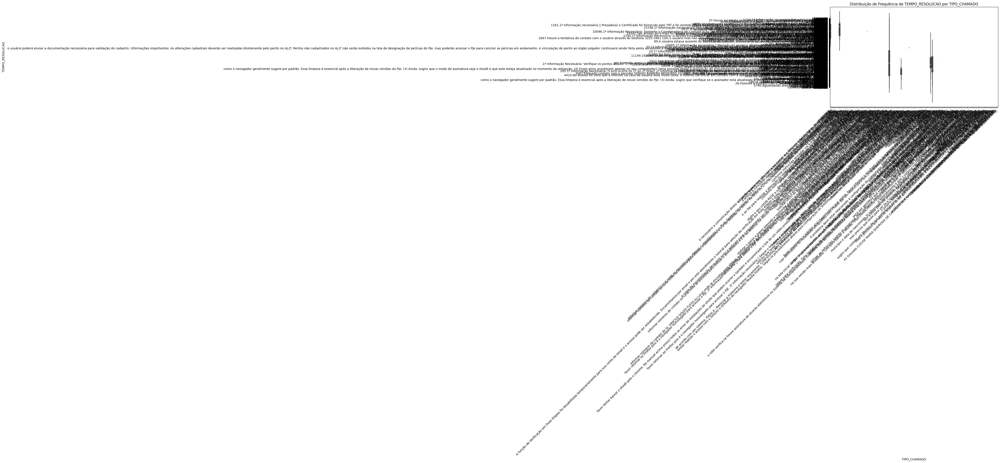

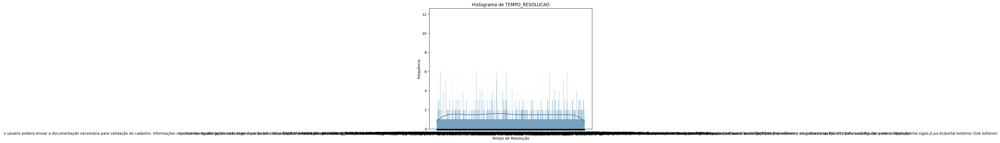

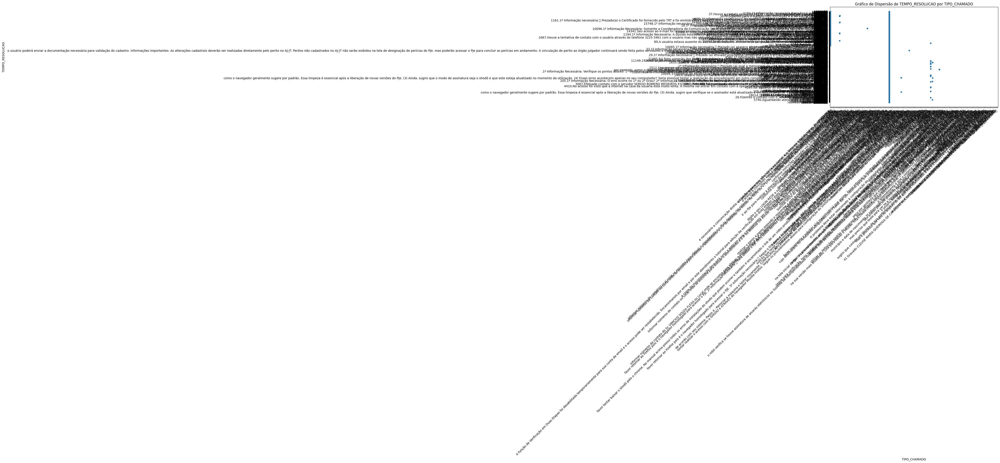

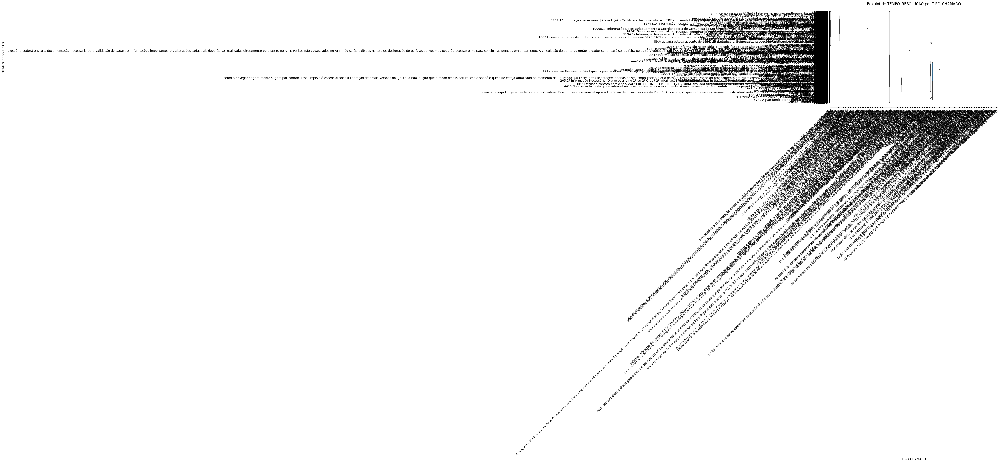

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# 1. Distribuição de Frequência com GRUPO_SERVIÇO e TEMPO_RESOLUCAO
# Usando um gráfico de violino para mostrar a distribuição numérica
# para cada categoria nominal

plt.figure(figsize=(10, 6))
sns.violinplot(x='TIPO_CHAMADO', y='TEMPO_RESOLUCAO', data=df_chamados)
plt.title('Distribuição de Frequência de TEMPO_RESOLUCAO por TIPO_CHAMADO')
plt.xticks(rotation=45, ha='right')  # Rotaciona os rótulos do eixo x para melhor legibilidade
plt.show()


# 2. Histograma, Gráfico de Dispersão e Boxplot

# Histograma para TEMPO_RESOLUCAO
plt.figure(figsize=(8, 6))
sns.histplot(df_chamados['TEMPO_RESOLUCAO'], bins=20, kde=True)
plt.title('Histograma de TEMPO_RESOLUCAO')
plt.xlabel('Tempo de Resolução')
plt.ylabel('Frequência')
plt.show()

# Gráfico de Dispersão para TIPO_CHAMADO e TEMPO_RESOLUCAO
# Usando jitter para visualizar melhor a densidade dos pontos
plt.figure(figsize=(10, 6))
sns.stripplot(x='TIPO_CHAMADO', y='TEMPO_RESOLUCAO', data=df_chamados, jitter=True)
plt.title('Gráfico de Dispersão de TEMPO_RESOLUCAO por TIPO_CHAMADO')
plt.xticks(rotation=45, ha='right')
plt.show()

# Boxplot para TEMPO_RESOLUCAO por TIPO_CHAMADO
plt.figure(figsize=(10, 6))
sns.boxplot(x='TIPO_CHAMADO', y='TEMPO_RESOLUCAO', data=df_chamados)
plt.title('Boxplot de TEMPO_RESOLUCAO por TIPO_CHAMADO')
plt.xticks(rotation=45, ha='right')
plt.show()


# ***Usando o YData Profiling***

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 11/11 [00:02<00:00,  4.87it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:

# 1. Distribuição de Frequência com GRUPO_SERVIÇO e TEMPO_RESOLUCAO
# Usando um gráfico de violino para mostrar a distribuição numérica
# para cada categoria nominal

plt.figure(figsize=(10, 6))
sns.violinplot(x='GRUPO_SERVICO', y='TEMPO_RESOLUCAO', data=df_chamados)
plt.title('Distribuição de Frequência de TEMPO_RESOLUCAO por GRUPO_SERVIÇO')
plt.xticks(rotation=45, ha='right')  # Rotaciona os rótulos do eixo x para melhor legibilidade
plt.show()


# 2. Histograma, Gráfico de Dispersão e Boxplot

# Histograma para TEMPO_RESOLUCAO
plt.figure(figsize=(8, 6))
sns.histplot(df_chamados['TEMPO_RESOLUCAO'], bins=20, kde=True)
plt.title('Histograma de TEMPO_RESOLUCAO')
plt.xlabel('Tempo de Resolução')
plt.ylabel('Frequência')
plt.show()

# Gráfico de Dispersão para GRUPO_SERVIÇO e TEMPO_RESOLUCAO
# Usando jitter para visualizar melhor a densidade dos pontos
plt.figure(figsize=(10, 6))
sns.stripplot(x='GRUPO_SERVICO', y='TEMPO_RESOLUCAO', data=df_chamados, jitter=True)
plt.title('Gráfico de Dispersão de TEMPO_RESOLUCAO por GRUPO_SERVICO')
plt.xticks(rotation=45, ha='right')
plt.show()

# Boxplot para TEMPO_RESOLUCAO por GRUPO_SERVIÇO
plt.figure(figsize=(10, 6))
sns.boxplot(x='GRUPO_SERVIÇO', y='TEMPO_RESOLUCAO', data=df_chamados)
plt.title('Boxplot de TEMPO_RESOLUCAO por GRUPO_SERVICO')
plt.xticks(rotation=45, ha='right')
plt.show()

ValueError: Could not interpret value `TEMPO_RESOLUCAO` for `y`. An entry with this name does not appear in `data`.

<Figure size 1000x600 with 0 Axes>